In [23]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix,classification_report 


In [24]:
df=pd.read_csv('cancer_data.csv')
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [25]:
df.drop(['id','Unnamed: 32'], axis=1, inplace=True)
df['diagnosis']=df['diagnosis'].map({'M':1,'B':0})
df.head(5)

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,1,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,1,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,1,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,1,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [26]:
X=df.drop('diagnosis',axis=1)
y=df['diagnosis']

In [27]:
scaler=StandardScaler()
scaled_data=scaler.fit_transform(X)
print(scaled_data[:2])

[[ 1.09706398e+00 -2.07333501e+00  1.26993369e+00  9.84374905e-01
   1.56846633e+00  3.28351467e+00  2.65287398e+00  2.53247522e+00
   2.21751501e+00  2.25574689e+00  2.48973393e+00 -5.65265059e-01
   2.83303087e+00  2.48757756e+00 -2.14001647e-01  1.31686157e+00
   7.24026158e-01  6.60819941e-01  1.14875667e+00  9.07083081e-01
   1.88668963e+00 -1.35929347e+00  2.30360062e+00  2.00123749e+00
   1.30768627e+00  2.61666502e+00  2.10952635e+00  2.29607613e+00
   2.75062224e+00  1.93701461e+00]
 [ 1.82982061e+00 -3.53632408e-01  1.68595471e+00  1.90870825e+00
  -8.26962447e-01 -4.87071673e-01 -2.38458552e-02  5.48144156e-01
   1.39236330e-03 -8.68652457e-01  4.99254601e-01 -8.76243603e-01
   2.63326966e-01  7.42401948e-01 -6.05350847e-01 -6.92926270e-01
  -4.40780058e-01  2.60162067e-01 -8.05450380e-01 -9.94437403e-02
   1.80592744e+00 -3.69203222e-01  1.53512599e+00  1.89048899e+00
  -3.75611957e-01 -4.30444219e-01 -1.46748968e-01  1.08708430e+00
  -2.43889668e-01  2.81189987e-01]]


In [28]:
pca=PCA(n_components=2)
x_pca=pca.fit_transform(scaled_data)
print(x_pca[:2])

[[ 9.19283683  1.94858307]
 [ 2.3878018  -3.76817174]]


In [29]:
print("Explained Variance: ",pca.explained_variance_ratio_)
print("Cumilative: ",np.cumsum(pca.explained_variance_ratio_))

Explained Variance:  [0.44272026 0.18971182]
Cumilative:  [0.44272026 0.63243208]


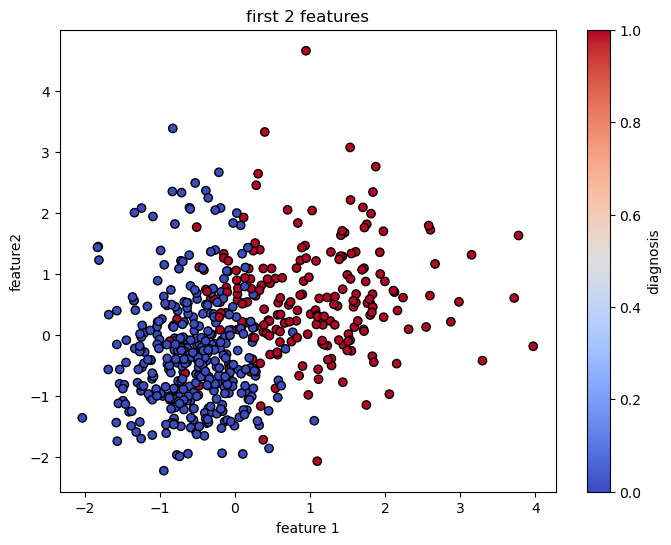

In [30]:
plt.figure(figsize=(8,6))
plt.scatter(scaled_data[:,0],scaled_data[:,1],c=y,cmap='coolwarm',edgecolor='k')
plt.xlabel("feature 1")
plt.ylabel("feature2")
plt.title("first 2 features")
plt.colorbar(label="diagnosis")
plt.show()



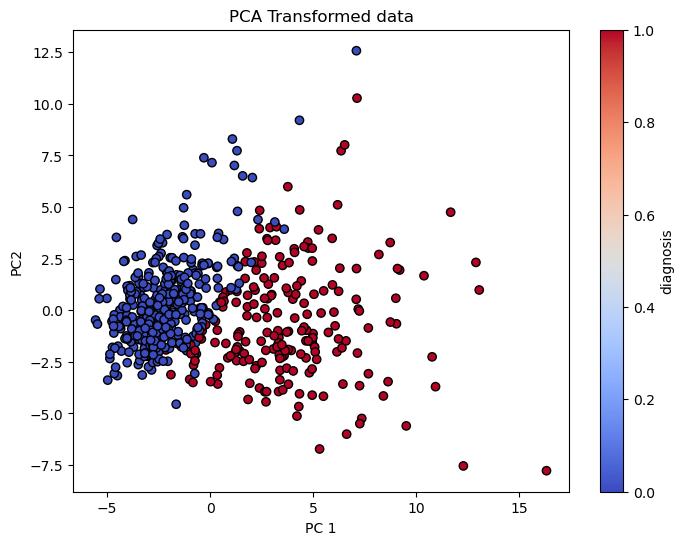

In [31]:
plt.figure(figsize=(8,6))
plt.scatter(x_pca[:,0],x_pca[:,1],c=y,cmap='coolwarm',edgecolor='k')
plt.xlabel("PC 1")
plt.ylabel("PC2")
plt.title("PCA Transformed data")
plt.colorbar(label="diagnosis")
plt.show()


array([[<Axes: xlabel='diagnosis', ylabel='diagnosis'>,
        <Axes: xlabel='radius_mean', ylabel='diagnosis'>,
        <Axes: xlabel='texture_mean', ylabel='diagnosis'>,
        <Axes: xlabel='perimeter_mean', ylabel='diagnosis'>,
        <Axes: xlabel='area_mean', ylabel='diagnosis'>,
        <Axes: xlabel='smoothness_mean', ylabel='diagnosis'>,
        <Axes: xlabel='compactness_mean', ylabel='diagnosis'>,
        <Axes: xlabel='concavity_mean', ylabel='diagnosis'>,
        <Axes: xlabel='concave points_mean', ylabel='diagnosis'>,
        <Axes: xlabel='symmetry_mean', ylabel='diagnosis'>,
        <Axes: xlabel='fractal_dimension_mean', ylabel='diagnosis'>,
        <Axes: xlabel='radius_se', ylabel='diagnosis'>,
        <Axes: xlabel='texture_se', ylabel='diagnosis'>,
        <Axes: xlabel='perimeter_se', ylabel='diagnosis'>,
        <Axes: xlabel='area_se', ylabel='diagnosis'>,
        <Axes: xlabel='smoothness_se', ylabel='diagnosis'>,
        <Axes: xlabel='compactness_se', yla

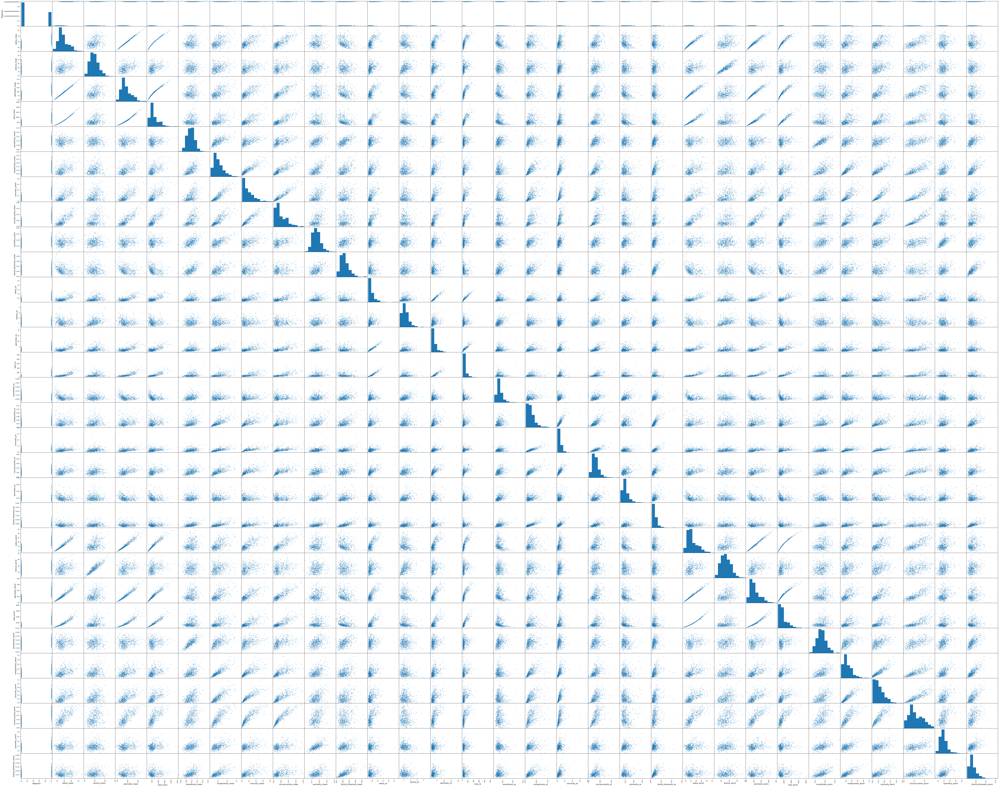

In [34]:
from pandas.plotting import scatter_matrix
scatter_matrix(df, figsize=(100,80))

In [40]:
X_train,X_test,y_train,y_test=train_test_split(x_pca,y,test_size=0.2,random_state=42)
model=LogisticRegression() 
model.fit(X_train,y_train)
y_pred=model.predict(X_test)
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.99      1.00      0.99        71
           1       1.00      0.98      0.99        43

    accuracy                           0.99       114
   macro avg       0.99      0.99      0.99       114
weighted avg       0.99      0.99      0.99       114



In [42]:
X_train,X_test,y_train,y_test=train_test_split(df,y,test_size=0.2,random_state=42)
model=LogisticRegression()
model.fit(X_train,y_train)
y_pred=model.predict(X_test)
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        71
           1       1.00      1.00      1.00        43

    accuracy                           1.00       114
   macro avg       1.00      1.00      1.00       114
weighted avg       1.00      1.00      1.00       114



C:\Users\test1\AppData\Roaming\Python\Python311\site-packages\sklearn\linear_model\_logistic.py:473: ConvergenceWarning: lbfgs failed to converge after 100 iteration(s) (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT

Increase the number of iterations to improve the convergence (max_iter=100).
You might also want to scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [47]:
x_reconstructed=pca.inverse_transform(x_pca)
reconstruction_loss=np.mean((scaled_data-x_reconstructed)**2)
print(f"reconstruction Loss: {reconstruction_loss:4f}")

reconstruction Loss: 0.367568
